<a href="https://colab.research.google.com/github/Kiwihead15/Car_Detector/blob/main/Workshop_1_Digital_Image_Representation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial - Digital Image Representation with PIL, NumPy, and PyTorch

#### Author: Antonio Rueda-Toicen

**antonio.rueda.toicen 'at' hpi 'dot' de**


[![Creative Commons License](https://i.creativecommons.org/l/by/4.0/88x31.png)](http://creativecommons.org/licenses/by/4.0/)

This work is licensed under a [Creative Commons Attribution 4.0 International License](http://creativecommons.org/licenses/by/4.0/).

## Three libraries with different purposes

We use:

* PIL (Python Image Library) for storage of images as PNG and JPEG files
* NumPy for image plotting with `matplotlib` and processing of data on the CPU
* PyTorch (aka `torch`) for neural networks and GPU / TPU usage (`CUDA` in NVIDIA GPUs)

All three of these libraries represent images as  "tensors" aka n-dimensional arrays.

## Imports

In [1]:
import torch
import torch.nn as nn
from PIL import Image
import numpy as np
import torchvision.datasets as datasets
import skimage.io as io
import torchvision.transforms.v2 as transforms
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import torchvision.models as models
from pathlib import Path
import os

## Shades of gray from the `uint8` type

PIL images use `uint8` by default because:

* 1 byte per pixel component (efficient)
* 256 values (0-255) per channel is enough for human vision
* Industry standard for JPEGs and PNGs
* Maximum compatibility with other software and monitors (256 levels per color channel)

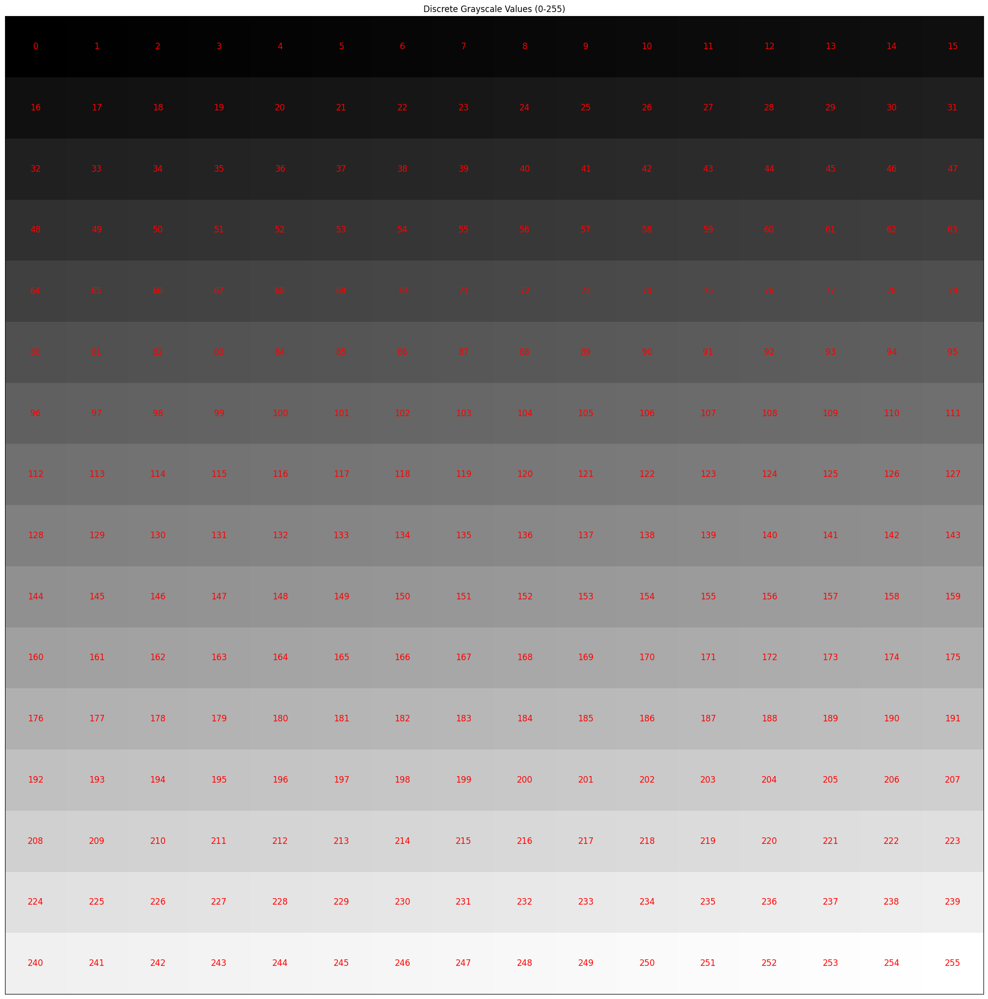

In [4]:
# Create a figure and axis
fig, ax = plt.subplots(figsize=(20, 20))

# Number of grayscale values (0-255)
num_values = 256

# Calculate the grid dimensions (16x16 grid for 256 values)
grid_size = int(np.sqrt(num_values))
square_size = 1.0

# Initialize the plot with white background
ax.set_xlim(0, grid_size * square_size)
ax.set_ylim(0, grid_size * square_size)
ax.set_aspect('equal')

# Draw each shade of gray as a separate square
for i in range(num_values):
    # Calculate grid position (row, column)
    row = i // grid_size
    col = i % grid_size

    # Calculate position coordinates
    x = col * square_size
    y = (grid_size - 1 - row) * square_size  # Invert y to have 0 at the bottom

    # Calculate gray value (0-1 for matplotlib)
    gray_value = i / 255

    # Create and add the square
    square = Rectangle((x, y), square_size, square_size,
                      facecolor=(gray_value, gray_value, gray_value),
                      edgecolor='none')
    ax.add_patch(square)

    # Add text label (showing value) to every square - all in red
    ax.text(x + square_size/2, y + square_size/2, str(i),
            ha='center', va='center',
            color='red',
            fontsize=12)

# Remove ticks
ax.set_xticks([])
ax.set_yticks([])

# Add title
plt.title('Discrete Grayscale Values (0-255)')


plt.tight_layout()
plt.show()

## Representing colors with RGB in a NumPy n-dimensional array

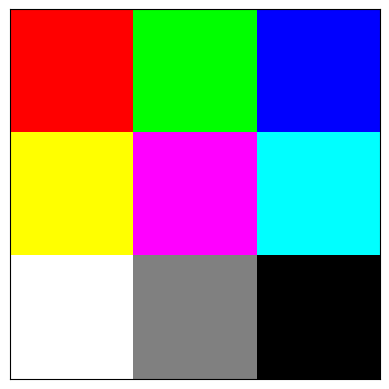

In [ ]:
# Create a3x3 RGB image array
rgb_image = np.array([
   # First row of pixels
   [[255, 0, 0],    # Pure red pixel
    [0, 255, 0],    # Pure green pixel
    [0, 0, 255]],   # Pure blue pixel

   # Second row of pixels
   [[255, 255, 0],  # Yellow pixel (red + green)
    [255, 0, 255],  # Magenta pixel (red + blue)
    [0, 255, 255]], # Cyan pixel (green + blue)

   # Third row of pixels
   [[255, 255, 255],# White pixel (all colors maximum)
    [128, 128, 128],# Gray pixel (all colors at half intensity)
    [0, 0, 0]]      # Black pixel (all colors minimum)
])

plt.xticks([])  # Remove x-axis ticks
plt.yticks([])  # Remove y-axis ticks
plt.imshow(rgb_image);



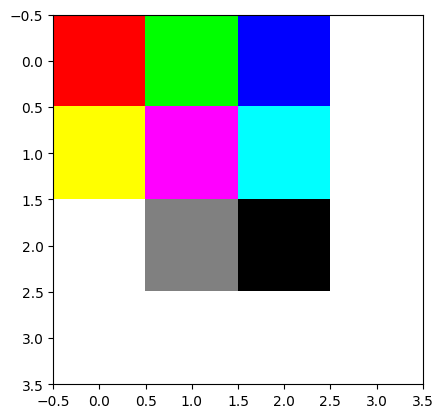

In [10]:
# Add a additional white row and column
rgb_image_2 = np.array([
   # First row of pixels
   [[255, 0, 0],    # Pure red pixel
    [0, 255, 0],    # Pure green pixel
    [0, 0, 255],    # Pure blue pixel
    [255,255,255]], # White pixel (all colors maximum)

   # Second row of pixels
   [[255, 255, 0],  # Yellow pixel (red + green)
    [255, 0, 255],  # Magenta pixel (red + blue)
    [0, 255, 255],  # Cyan pixel (green + blue)
    [255,255,255]], # White pixel (all colors maximum)

   # Third row of pixels
   [[255, 255, 255],# White pixel (all colors maximum)
    [128, 128, 128],# Gray pixel (all colors at half intensity)
    [0, 0, 0],      # Black pixel (all colors minimum)
    [255,255,255]],  # White pixel (all colors maximum)

    # Fourth row of pixels
   [[255, 255, 255],# White pixel (all colors maximum)
    [255, 255, 255],# White pixel (all colors maximum)
    [255, 255, 255],# White pixel (all colors maximum)
    [255,255,255]]  # White pixel (all colors maximum)
])

#plt.xticks([])  # Remove x-axis ticks
#plt.yticks([])  # Remove y-axis ticks
plt.imshow(rgb_image);

In [11]:
# We select a row and a column
# Indexing starts at 0, as in standard Python
# We index first with height, then width
pixel = rgb_image[2, 0]

# Will show [255, 255, 255] (white)
# Q: Which index should we use to print magenta’s values?
print(f"RGB values: {pixel}")


RGB values: [255 255 255]


In [13]:
# We select a row and a column
# Indexing starts at 0, as in standard Python
# We index first with height, then width
pixel = rgb_image[1, 1]

# Will show [255, 0, 255] (magenta)
# Q: Which index should we use to print magenta’s values?
print(f"RGB values: {pixel}")

RGB values: [255   0 255]


In [14]:
# We select a row and a column
# Indexing starts at 0, as in standard Python
# We index first with height, then width
pixel = rgb_image_2[1, 2]

# Will show [0, 255, 255] (cyan)
# Q: Which index should we use to print magenta’s values?
print(f"RGB values: {pixel}")

RGB values: [  0 255 255]


## Image arithmetic and indexing in NumPy

Taken from [source](https://realpython.com/image-processing-with-the-python-pillow-library/).

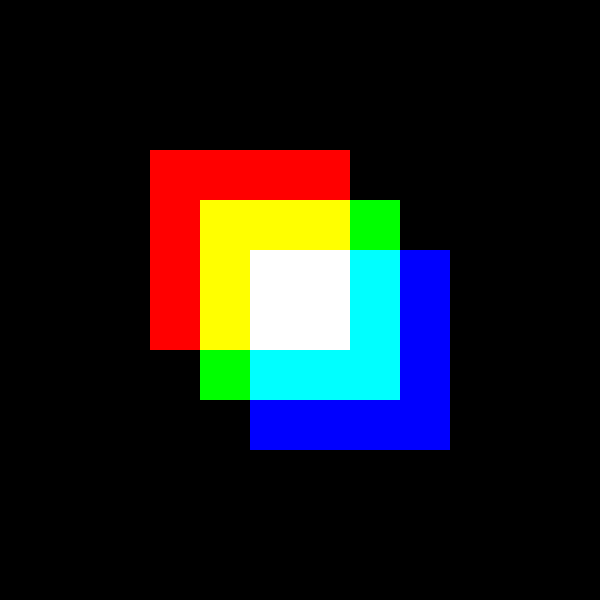

In [2]:
# Create arrays of of zeros
red = np.zeros((600, 600))
green = np.zeros((600, 600))
blue = np.zeros((600, 600))

# Set sections to maximum intensity
red[150:350, 150:350] = 255
green[200:400, 200:400] = 255
blue[250:450, 250:450] = 255

red_img = Image.fromarray(red).convert("L")
green_img = Image.fromarray(green).convert("L")
blue_img = Image.fromarray((blue)).convert("L")

# Merge channels
square_img = Image.merge("RGB", (red_img, green_img, blue_img))
square_img

Grayscale Modes:

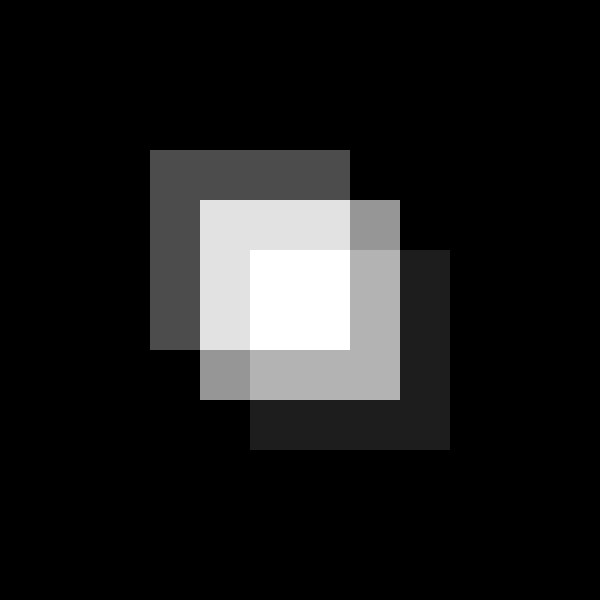

In [32]:
# "L" (Luminance): This represents grayscale images using a single channel for intensity,
# with values ranging from 0 (black) to 255 (white).
square_gray_img = square_img.convert("L")
square_gray_img

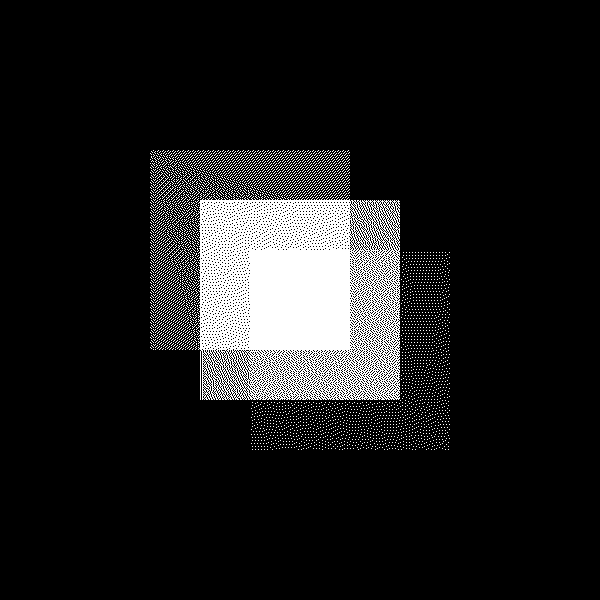

In [33]:
# "1" (1-bit Pixels): This mode uses only two values, 0 and 1,
# to represent black and white pixels, respectively. It's useful for creating black and white masks or simple line art.
square_bimodel_img = square_img.convert("1")
square_bimodel_img

Color Modes:

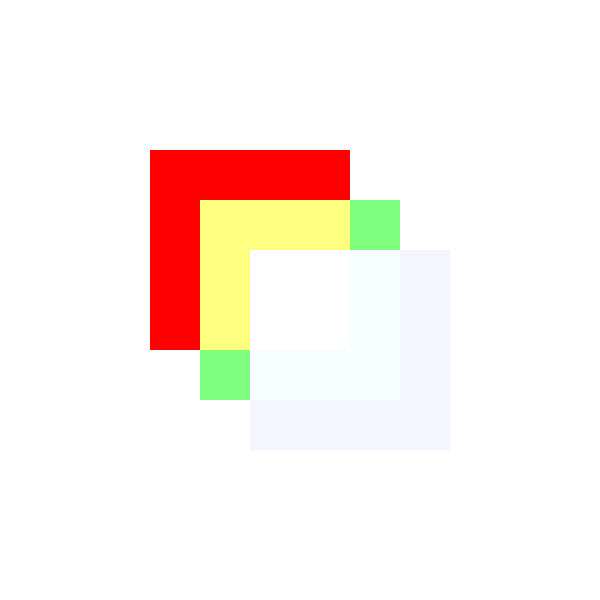

In [40]:
# "RGBA" (Red, Green, Blue, Alpha): An extension of RGB that includes an alpha channel for transparency.
# The alpha channel determines the opacity of each pixel,
# with 0 being fully transparent and 255 being fully opaque.

alpha = np.zeros((600, 600))

alpha[150:350, 150:350] = 255   # highest opacity over red square
alpha[200:400, 200:400] = 128   # medium opacity over green square
alpha[250:450, 250:450] = 10    # low opacity = high transparency over blue square

alpha_img = Image.fromarray(alpha).convert("L")

square_rgba_img = Image.merge("RGBA", (red_img, green_img, blue_img, alpha_img))
square_rgba_img

Other color modes:
- "CMYK" (Cyan, Magenta, Yellow, Black): This mode is primarily used for printing, representing colors as combinations of cyan, magenta, yellow, and black inks.
- "YCbCr" (Luminance, Chrominance): This mode separates luminance (brightness) from chrominance (color) information and is often used in video compression.

Other Modes:

- "P" (Palette): This mode uses a color palette to store image data, where each pixel value is an index into the palette. It's efficient for images with a limited number of colors.
- "F" (32-bit Floating-point): This mode stores pixel values as 32-bit floating-point numbers, often used for scientific or medical images.
- "I" (32-bit Integer): Similar to "F" but stores pixel values as 32-bit integers.
- "LA" (Luminance, Alpha): Represents grayscale images with an alpha channel for transparency.
- "PA" (Palette, Alpha): Similar to "P" but with an alpha channel.

## The MNIST dataset of grayscale digit images

The [MNIST database](https://en.wikipedia.org/wiki/MNIST_database) is one of the most widely used computer vision datasets. We can download it from `torchvision.datasets` and inspect it through:
https://try.fiftyone.ai/datasets/mnist/samples

In [41]:
# Download the MNIST digits from torchvision.datasets
mnist_dataset = datasets.MNIST(
    root="./data",  # Specify the directory to store the dataset
    train=False,  # Download the test set
    download=True,  # Download if not already present
    #transform=transforms.ToImage(),  # Convert PIL images to torch tensors
)

len(mnist_dataset)

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 9.91M/9.91M [00:00<00:00, 134MB/s]


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 28.9k/28.9k [00:00<00:00, 44.4MB/s]


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 1.65M/1.65M [00:00<00:00, 79.9MB/s]

Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw



Failed to download (trying next):
HTTP Error 404: Not Found



100%|██████████| 4.54k/4.54k [00:00<00:00, 5.12MB/s]


Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



10000

In [44]:
# What we get from the dataset is a list of tuples
# the images come alongside their labels
# Images are already in the PIL image format
mnist_dataset[0]

# The tuple is (<PIL.Image.Image image mode=L size=28x28>, 7) where <PIL.Image.Image image mode=L size=28x28> is the image (a PIL object), and 7 is the labels since it is a n image of number 7

(<PIL.Image.Image image mode=L size=28x28>, 7)

In [45]:
# PIL images can be saved or read to disk as jpg or png files
mnist_dataset[0][0].save("./mnist_digit.jpg")

In [46]:
# We can check that mnist_digit.jpg has been saved and is
# now a file on our Colab instance
!ls

data  mnist_digit.jpg  sample_data


In [47]:
# Now we load the digit from disk
mnist_pil_image = Image.open("./mnist_digit.jpg")
# The digit renders on its true size of 28x28 pixels on Colab
mnist_pil_image

In [48]:
# We have 28 pixels of width, 28 pixels of height
# width is always the first dimension in PIL
width, height = mnist_pil_image.size
width, height

(28, 28)

In [49]:
# Grayscale images have the 'L' mode
mnist_pil_image.mode

'L'

In [50]:
# Convert PIL image to NumPy
mnist_np_array = np.array(mnist_pil_image)
# Check the shape of the array
mnist_np_array.shape

(28, 28)

In [51]:
# We verify that the range of values is between 0 (black) to 255 (white)
mnist_np_array.min(), mnist_np_array.max()

(0, 255)

In [52]:
# When they are read, images are uint8
mnist_np_array.dtype

dtype('uint8')

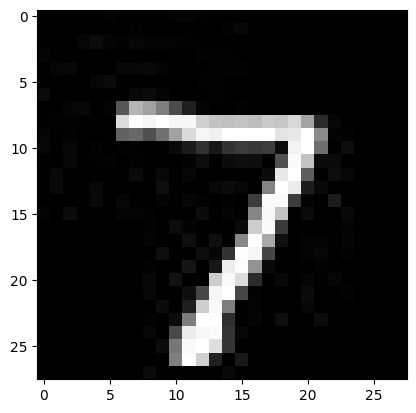

In [60]:
# PIL images are implicitly converted to NumPy and upsampled
# when passed to matplotlib

# Experiment: Verify that the line below produces the same output
# when uncommented
#plt.imshow(mnist_pil_image, cmap="gray");

plt.imshow(mnist_np_array, cmap="gray");


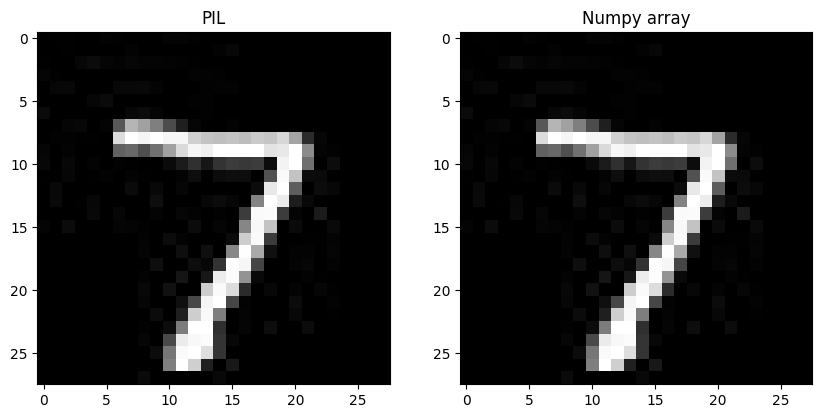

In [59]:
fig, axes = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

# Plot the first image (PIL)
axes[0].imshow(mnist_pil_image, cmap="gray")
axes[0].set_title('PIL')
#axes[0].axis('off')  # Turn off axis ticks and labels

# Plot the second image (Numpy array)
axes[1].imshow(mnist_np_array, cmap="gray")
axes[1].set_title("Numpy array")
#axes[1].axis('off')

plt.show()

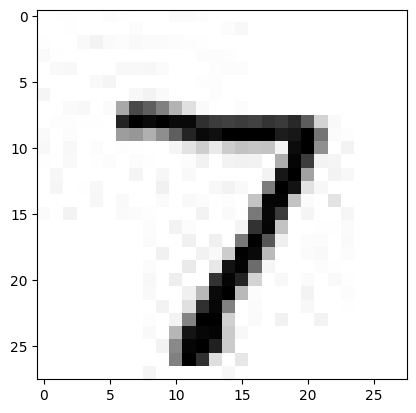

In [62]:
# 255 minus current pixel values with NumPy’s broadcasting
np_array_neg = 255 - mnist_np_array
plt.imshow(np_array_neg, cmap="gray");


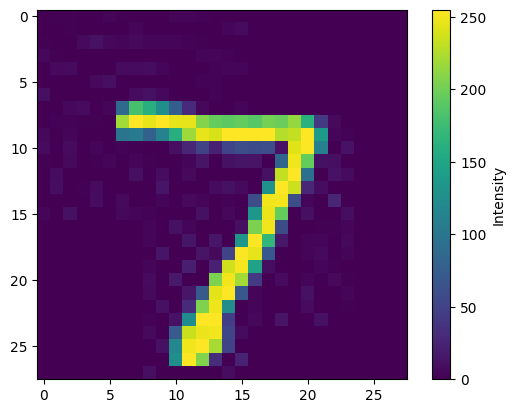

In [64]:
# The default color map (cmap) of matplotlib is 'viridis'
plt.imshow(mnist_pil_image, cmap='viridis')
# We add a colorbar to the plot
plt.colorbar(label='Intensity')
plt.show()

## Intensities for RGB images in NumPy

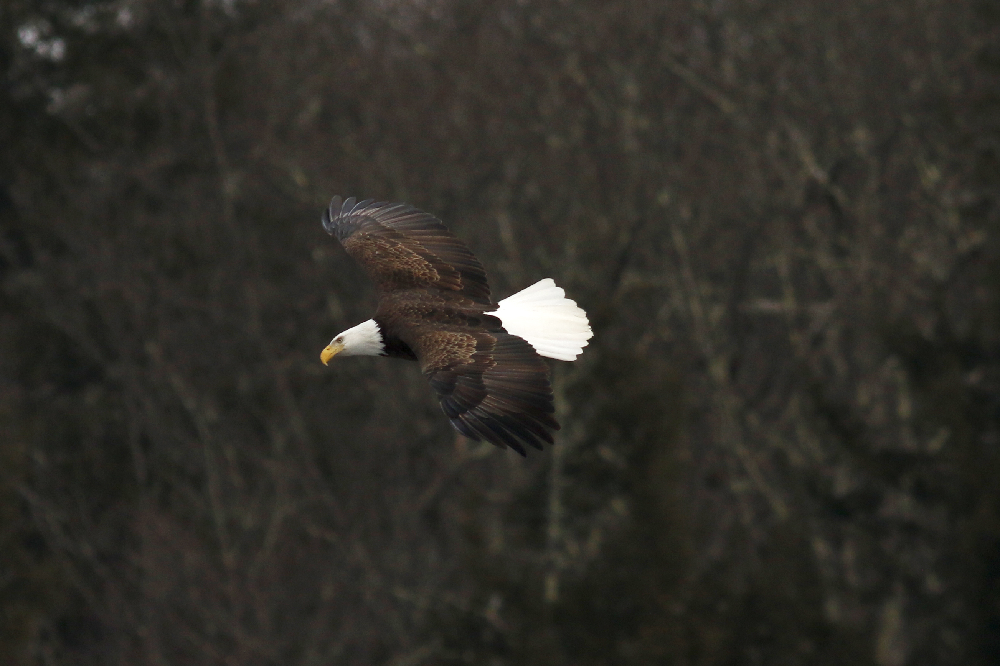

In [66]:
# Images with raw.githubusercontent.com URLs can be imported into Colab with skimage.io.imread(url)
image_url = "https://www.nps.gov/upde/planyourvisit/images/PS_9914-cropped.jpg?raw=true"
# The image is loaded as a NumPy array
rgb_np_array = io.imread(image_url)
# We turn the NumPy array into a PIL image
rgb_pil_image = Image.fromarray(rgb_np_array)
rgb_pil_image

In [67]:
# The mode for the color PIL image is RGB
rgb_pil_image.mode

'RGB'

In [68]:
# Images in NumPy are saved as
# Height (H), Width(W), Channels (C)
H, W, C = rgb_np_array.shape
H, W, C

(1738, 2606, 3)

## Plotting individual color channels as intensities

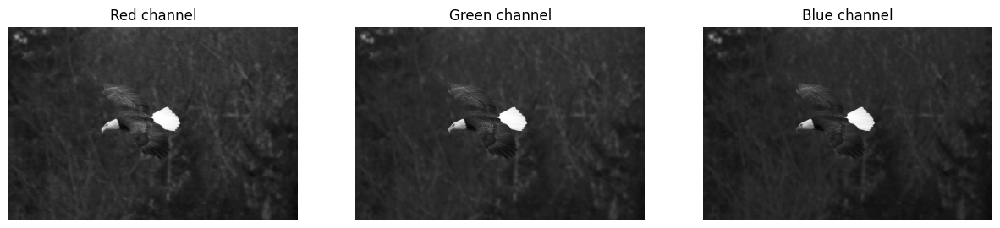

In [69]:
fig, axes = plt.subplots(1, 3, figsize=(15, 15))

# Plot the Red channel
axes[0].imshow(rgb_np_array[:, :, 0], cmap='gray')
axes[0].set_title("Red channel")
axes[0].axis('off')  # Turn off axis ticks and labels

# Plot the Green channel
axes[1].imshow(rgb_np_array[:, :, 1], cmap='gray')
axes[1].set_title("Green channel")
axes[1].axis('off')

# Plot the Blue channel
axes[2].imshow(rgb_np_array[:, :, 2], cmap='gray')
axes[2].set_title("Blue channel")
axes[2].axis('off')

plt.show()

## Adding color to intensity images

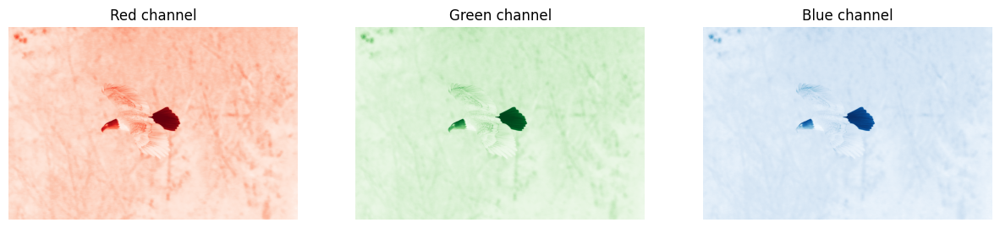

In [70]:
# Create a figure with 3 subplots arranged horizontally
fig, axes = plt.subplots(1, 3, figsize=(15, 15))

# Plot the Red channel
axes[0].imshow(rgb_np_array[:, :, 0], cmap='Reds')
axes[0].set_title("Red channel")
axes[0].axis('off')  # Turn off axis ticks and labels

# Plot the Green channel
axes[1].imshow(rgb_np_array[:, :, 1], cmap='Greens')
axes[1].set_title("Green channel")
axes[1].axis('off')

# Plot the Blue channel
axes[2].imshow(rgb_np_array[:, :, 2], cmap='Blues')
axes[2].set_title("Blue channel")
axes[2].axis('off')

plt.show()

## Intro to `torch` tensors

PyTorch is built for training neural networks. We will use a simple model for digit classification and another pretrained one for the next examples. Don't bother too much about its details now. We delve into the details of these networks in the next sessions.

For now, they are only for us to explore how to work with grayscale and RGB images in `torch`.

In [71]:
# Define a simple MNIST classification model (untrained)
simple_mnist_model = nn.Sequential(
    nn.Flatten(),  # Flatten the 28x28 image into a 784-dimensional vector
    nn.Linear(28 * 28, 128),  # First fully connected layer with 128 units
    nn.ReLU(),  # ReLU activation function
    nn.Linear(128, 10),  # Second fully connected layer with 10 units (for 10 classes)
)

# We won't be training now, so we set the model to evaluation mode.
simple_mnist_model.eval()

Sequential(
  (0): Flatten(start_dim=1, end_dim=-1)
  (1): Linear(in_features=784, out_features=128, bias=True)
  (2): ReLU()
  (3): Linear(in_features=128, out_features=10, bias=True)
)

In [72]:
# Load a pre-trained ResNet18 model to process color images
resnet18 = models.resnet18(weights="IMAGENET1K_V1")

# Set the model to evaluation mode
resnet18.eval()

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 105MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  




## Format for the order of color channels in `torch`

To feed tensors to a neural network,
`torch` image tensors should follow the format: `[N, C, H, W]` where:
* `N` = batch size (number of images)
* `C` = channels (e.g., 1 for grayscale, 3 for RGB)
* `H` = height in pixels
* `W` = width in pixels

NumPy arrays follow the `H, W, C` format.

PIL images follow the `W, H` and `mode` format.

It's important to understand that we *can* create tensors that do not follow `[N, C, H, W]` standard, however we cannot feed them to a `torch` neural network (or any other component that is a subclass or `torch.nn.Module`).





## `torch` tensors and `transforms.v2.ToImage()` vs `transforms.ToTensor()`

The `ToImage()` transform reshapes both NumPy arrays and PIL images into the format of `torch` tensors without changing their underlying data type. After applying `ToImage()`, the input becomes a `torch` tensor of type `torch.uint8`.

If the image isn't batched, `ToImage()` will not add a batch dimension.

The batch dimension is important to PyTorch because it needs to know on how many images it is operating when it is feeding data to a neural network.

In [73]:
# ToImage() Converts PIL images with W, H and mode format and NumPy arrays
# with H, W, C format
# to torch tensors with C, H, W format
torch_image_transform = transforms.Compose([transforms.ToImage(),
                                            transforms.ToDtype(torch.float32,
                                                               scale=True)])
rgb_torch_tensor = torch_image_transform(rgb_np_array)
rgb_torch_tensor.shape

torch.Size([3, 1738, 2606])

In [74]:
# Here we get the proper format
mnist_torch_tensor = torch_image_transform(mnist_pil_image)
mnist_torch_tensor.shape

torch.Size([1, 28, 28])

In [75]:
# Q: What happens if we remove transforms.ToDtype(torch.float32, scale=True)?
# Q: What happens if we remove unsqueeze(0)?
# Q: What is the the result of mnist_torch_tensor.unsqueeze(0).shape?
simple_mnist_model(mnist_torch_tensor.unsqueeze(0))

tensor([[ 0.0594,  0.0514,  0.0533, -0.2343, -0.0615, -0.1640, -0.0355,  0.0052,
          0.0994, -0.1249]], grad_fn=<AddmmBackward0>)

In [78]:
# Q: What happens if we remove transforms.ToDtype(torch.float32, scale=True)?

torch_image_transform_2 = transforms.Compose([transforms.ToImage()])
mnist_torch_tensor_2 = torch_image_transform_2(mnist_pil_image)
print(mnist_torch_tensor_2.shape)
simple_mnist_model(mnist_torch_tensor_2.unsqueeze(0))

torch.Size([1, 28, 28])


RuntimeError: mat1 and mat2 must have the same dtype, but got Byte and Float

In [79]:
# Q: What happens if we remove unsqueeze(0)?

torch_image_transform = transforms.Compose([transforms.ToImage(),transforms.ToDtype(torch.float32, scale=True)])
mnist_torch_tensor = torch_image_transform(mnist_pil_image)
print(mnist_torch_tensor.shape)
simple_mnist_model(mnist_torch_tensor)


torch.Size([1, 28, 28])


tensor([[ 0.0594,  0.0514,  0.0533, -0.2343, -0.0615, -0.1640, -0.0355,  0.0052,
          0.0994, -0.1249]], grad_fn=<AddmmBackward0>)

In [82]:
# Q: What is the the result of mnist_torch_tensor.unsqueeze(0).shape?
print(simple_mnist_model(mnist_torch_tensor).unsqueeze(0).shape)
print(simple_mnist_model(mnist_torch_tensor).shape)

torch.Size([1, 1, 10])
torch.Size([1, 10])


In [ ]:
# Q: Why do we have inf in this tensor?
mnist_tensor_unscaled = transforms.ToImage()(mnist_np_array)
torch.exp(mnist_tensor_unscaled)

tensor([[[1.0000e+00, 2.7183e+00, 2.7183e+00, 1.0000e+00, 1.0000e+00,
          2.0086e+01, 2.7183e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
          5.4598e+01, 5.4598e+01, 7.3891e+00, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 1.0000e+00],
         [1.0000e+00, 1.0000e+00, 2.7183e+00, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 2.0086e+01, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 2.0086e+01,
          1.0966e+03, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
          1.0000e+00, 1.0000e+00, 1.0000e+00],
         [2.7183e+00, 1.0000e+00, 1.0000e+00, 4.0343e+02, 5.9874e+04,
          1.4841e+02, 2.0086e+01, 4.0343e+02, 5.4598e+01, 5.4598e+01,
          2.0086e+01, 7.3891e+00, 2.7183e+00, 1.0000e+00, 1.0000e+

### The deprecated `transforms.ToTensor()` operation

The reshaping performed by `transforms.v2.ToImage()` was previously handled by `transforms.ToTensor()`, but this method has been deprecated because "it did too much" in a single step. In addition to reshaping the tensor to the `C, H, W` format, `transforms.ToTensor()` also divided all values by 255 and converted them to `torch.float32`.

As of March 2025, LLMs like ChatGPT, Gemini, and Claude will still recommend using `transforms.ToTensor()`.

The recommended practice is now to use:

```python
transforms.Compose([transforms.ToImage(), transforms.ToDType(torch.float32, scale=True)])
```

instead of `transforms.ToTensor()`, that will give us a deprecation warning.


In [ ]:
# Check out the output and the user warning
transforms.ToTensor()(mnist_pil_image)

/usr/local/lib/python3.11/dist-packages/torchvision/transforms/v2/_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


tensor([[[0.0000, 0.0039, 0.0039, 0.0000, 0.0000, 0.0118, 0.0039, 0.0000,
          0.0000, 0.0000, 0.0157, 0.0157, 0.0078, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0039, 0.0000, 0.0000, 0.0000, 0.0000, 0.0118,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0118, 0.0275,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000],
         [0.0039, 0.0000, 0.0000, 0.0235, 0.0431, 0.0196, 0.0118, 0.0235,
          0.0157, 0.0157, 0.0118, 0.0078, 0.0039, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000],
         [0.0196, 0.0039, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0118, 0.0118, 0.0078, 0.0000,
          0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,

## Where do `torch` tensors run?

PyTorch is able to run tensors on the GPU or TPU, however by default they are on the CPU. It's important to know that both the `torch` neural network model and the input tensor need to be on the same device.

In [ ]:
# We can create torch tensors out of numpy arrays
# keeping their original shape
rgb_torch_tensor = torch.tensor(rgb_np_array)
rgb_torch_tensor.device

device(type='cpu')

In [ ]:
# The shape of the torch tensor is the same as the one of the original
# NumPy array, we will need to adjust this before feeding our data to a
# PyTorch neural network
rgb_torch_tensor.shape, rgb_np_array.shape

(torch.Size([1200, 1800, 3]), (1200, 1800, 3))

## The `tensor_name.to(device)` syntax

We use the the `tensor_name.to(device)` syntax to move tensors in and out of the GPU / TPU. To make the GPU or TPU available in Google Colab, go into Runtime -> Change Runtime Type and select your preferred device.


In [ ]:
# "cuda" stands for "Compute Unified Device Architecture"
# which is NVIDIA's library for writing GPU code
# it's only available on GPUs or TPUs
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

## Creating a FiftyOne dataset

FiftyOne runs on MongoDB and allows us to add a layer of metadata to our image collection. We will use to keep our visualizations and experiments together. This layer of metadata is what we call a fiftyone dataset.

The only required field for the dataset is a path for each image. We call each added image to the dataset a sample.

We will use `skimage.io` to get images from URLs and `PIL` to save them to local disk as JPEGs. This is the easiest way to create a FiftyOne dataset.

In [ ]:
!pip install fiftyone -q

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.7/99.7 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.4/112.4 kB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.8/74.8 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 73.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.0/72.0 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 943.0/943.0 kB 60.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 11.6 MB/s eta 0:00:

In [ ]:
import os
import fiftyone as fo
from pathlib import Path
from PIL import Image
from skimage import io
import numpy as np

# URLs of images to download
urls = ['https://github.com/andandandand/image-dataset-curation/blob/main/images/red_apple_1.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/red_apple_2.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/green_apple_1.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/green_apple_2.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/orange_1.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/orange_2.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/toy_car_1.png?raw=true',
        'https://github.com/andandandand/image-dataset-curation/blob/main/images/toy_car_2.png?raw=true']

# Download and save images
im_arrays = [io.imread(url) for url in urls]
save_path = Path("./apples_oranges_cars")
os.makedirs(save_path, exist_ok=True)
pil_images = [Image.fromarray(im_array).convert("RGB") for im_array in im_arrays]

# Save images and track filenames
image_paths = []
for index, imag in enumerate(pil_images):
    filename = f"{Path(urls[index]).stem}.jpg"
    filepath = save_path / filename
    imag.save(filepath)
    image_paths.append(filepath)

print("Images saved to:", os.listdir(save_path))

# Create a FiftyOne dataset from the local images
dataset_name = "apples-oranges-cars"

# Check if the dataset exists
if fo.dataset_exists(dataset_name):
    # Delete existing dataset
    fo.delete_dataset(dataset_name)
    print(f"Existing dataset '{dataset_name}' deleted.")

# Create a new dataset
dataset = fo.Dataset(dataset_name)
print(f"Dataset '{dataset_name}' created.")

# Add image classifications based on filename
for image_path in image_paths:
    # Create a sample with the filepath
    sample = fo.Sample(filepath=str(image_path))

    # Extract a simple label from the filename
    filename = os.path.basename(image_path)
    if "apple" in filename:
        label = "apple"
        if "red" in filename:
            label = "red_apple"
        elif "green" in filename:
            label = "green_apple"
    elif "orange" in filename:
        label = "orange"
    elif "car" in filename:
        label = "toy_car"
    else:
        label = "unknown"

    # Add the classification
    sample["classification"] = fo.Classification(label=label)

    # Add the sample to the dataset
    dataset.add_sample(sample)

# Persist the dataset
dataset.persistent = True
print(f"Dataset info: {dataset}")

# Verify dataset samples and paths
print(f"Number of samples: {len(dataset)}")
print("Sample filepaths:")
for sample in dataset.take(3):
    print(f"  - {sample.filepath} (Label: {sample.classification.label})")

# Launch the FiftyOne App to view the dataset
session = fo.launch_app(dataset)

Images saved to: ['red_apple_1.jpg', 'toy_car_2.jpg', 'orange_1.jpg', 'orange_2.jpg', 'green_apple_2.jpg', 'green_apple_1.jpg', 'toy_car_1.jpg', 'red_apple_2.jpg']
Dataset 'apples-oranges-cars' created.
Dataset info: Name:        apples-oranges-cars
Media type:  image
Num samples: 8
Persistent:  True
Tags:        []
Sample fields:
    id:               fiftyone.core.fields.ObjectIdField
    filepath:         fiftyone.core.fields.StringField
    tags:             fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:         fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    created_at:       fiftyone.core.fields.DateTimeField
    last_modified_at: fiftyone.core.fields.DateTimeField
    classification:   fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Classification)
Number of samples: 8
Sample filepaths:
  - /content/apples_oranges_cars/orange_1.jpg (Label: orange)
  - /content/apples_oranges_cars/red_apple_1.jpg


Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.3.1

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



INFO:fiftyone.core.session.session:
Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.3.1

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



## References

* [Image Processing With the Python Pillow Library](https://realpython.com/image-processing-with-the-python-pillow-library/)

* [Transforming and Augmenting Images](https://pytorch.org/vision/main/transforms.html)